<a href="https://colab.research.google.com/github/ecoCrafters/waste-detection/blob/kaggle-dataset/Collect_Data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pwd

/content


In [2]:
%cd /content/drive/Shareddrives/Capstone

/content/drive/Shareddrives/Capstone


In [ ]:
!pwd

/content/drive/Shareddrives/Capstone


# TACO Dataset

We are using the dataset with super category as the class label, as the category is too specific for our app.

![](http://tacodataset.org/img/super_cat_hist.png)

However, we will only select data with annotations that are above 200. As [this article](https://changsin.medium.com/how-many-images-do-you-need-for-object-detection-d33185629843) mentioned the minimum number of image data for training is around 150-500.

Also the "Unlabeled litter" and "Cigarette" annotation is useless for the purpose of our final app. So we will remove it.

But we are going to take the "Plastic container" label because this will be combined with other dataset source

## Download the data

In [ ]:
!git clone https://github.com/pedropro/TACO.git

Cloning into 'TACO'...
remote: Enumerating objects: 740, done.
remote: Counting objects: 100% (160/160), done.
remote: Compressing objects: 100% (71/71), done.
remote: Total 740 (delta 116), reused 132 (delta 89), pack-reused 580
Receiving objects: 100% (740/740), 98.85 MiB | 13.75 MiB/s, done.
Resolving deltas: 100% (493/493), done.
Updating files: 100% (25/25), done.


In [ ]:
%cd TACO

/content/drive/Shareddrives/Capstone/TACO


In [ ]:
!python download.py

Note. If for any reason the connection is broken. Just call me again and I will start where I left.
Finished


In [ ]:
%cd /content/drive/Shareddrives/Capstone

/content/drive/Shareddrives/Capstone


## Selecting the data

In [ ]:
import json
import pandas as pd
import numpy as np
import copy
import os

In [ ]:
DATA_PATH = '/content/drive/Shareddrives/Capstone/TACO/data/'
ANN_PATH = DATA_PATH + 'annotations.json'
 
with open(ANN_PATH, 'r') as f:
    dataset = json.loads(f.read())

categories = dataset['categories']
anns = dataset['annotations']
imgs = dataset['images']
nr_cats = len(categories)
nr_annotations = len(anns)
nr_images = len(imgs)

# Load categories and super categories
cat_names = []
super_cat_names = []
super_cat_ids = {}
super_cat_last_name = ''
nr_super_cats = 0
for cat_it in categories:
    cat_names.append(cat_it['name'])
    super_cat_name = cat_it['supercategory']
    # Adding new supercat
    if super_cat_name != super_cat_last_name:
        super_cat_names.append(super_cat_name)
        super_cat_ids[super_cat_name] = nr_super_cats
        super_cat_last_name = super_cat_name
        nr_super_cats += 1

print('Number of super categories:', nr_super_cats)
print('Number of categories:', nr_cats)
print('Number of annotations:', nr_annotations)
print('Number of images:', nr_images)

Number of super categories: 28
Number of categories: 60
Number of annotations: 4784
Number of images: 1500


In [ ]:
# Count annotations
cat_histogram = np.zeros(nr_cats,dtype=int)
for ann in anns:
    cat_histogram[ann['category_id']] += 1

In [ ]:
cat_ids_2_supercat_ids = {}
for cat in categories:
    cat_ids_2_supercat_ids[cat['id']] = super_cat_ids[cat['supercategory']]

# Count annotations
super_cat_histogram = np.zeros(nr_super_cats,dtype=int)
for ann in anns:
    cat_id = ann['category_id']
    super_cat_histogram[cat_ids_2_supercat_ids[cat_id]] +=1

# Convert to DataFrame
d ={'Super categories': super_cat_names, 'Number of annotations': super_cat_histogram}
sup_cat_df = pd.DataFrame(d)
sup_cat_df = sup_cat_df.sort_values('Number of annotations', 0, False)


<ipython-input-86-1374968da3a5>:14: FutureWarning: In a future version of pandas all arguments of DataFrame.sort_values except for the argument 'by' will be keyword-only.
  sup_cat_df = sup_cat_df.sort_values('Number of annotations', 0, False)


In [ ]:
sup_cat_df.head()

,Super categories,Number of annotations
15,Plastic bag & wrapper,850
27,Cigarette,667
26,Unlabeled litter,517
3,Bottle,439
4,Bottle cap,289


In [ ]:
cat_df = pd.DataFrame(categories)
cat_df.head()

,supercategory,id,name
0,Aluminium foil,0,Aluminium foil
1,Battery,1,Battery
2,Blister pack,2,Aluminium blister pack
3,Blister pack,3,Carded blister pack
4,Bottle,4,Other plastic bottle


In [ ]:
anns_df = pd.DataFrame(anns)
anns_df.head()

,id,image_id,category_id,segmentation,area,bbox,iscrowd
0,1,0,6,"[[561.0, 1238.0, 568.0, 1201.0, 567.0, 1175.0,...",403954.0,"[517.0, 127.0, 447.0, 1322.0]",0
1,2,1,18,"[[928.0, 1876.0, 938.0, 1856.0, 968.0, 1826.0,...",1071259.5,"[1.0, 457.0, 1429.0, 1519.0]",0
2,3,1,14,"[[617.0, 383.0, 703.0, 437.0, 713.0, 456.0, 72...",99583.5,"[531.0, 292.0, 1006.0, 672.0]",0
3,4,2,5,"[[670.0, 993.0, 679.0, 998.0, 684.0, 1001.0, 6...",73832.5,"[632.0, 987.0, 500.0, 374.0]",0
4,5,2,7,"[[647.0, 1028.0, 650.0, 1022.0, 653.0, 1016.0,...",915.0,"[632.0, 989.0, 44.0, 51.0]",0


Start selecting categories with number of annotations more than 200

In [ ]:
selected_supcat = sup_cat_df[(sup_cat_df['Number of annotations'] > 200)]['Super categories'].values
selected_supcat

array(['Plastic bag & wrapper', 'Cigarette', 'Unlabeled litter', 'Bottle',
       'Bottle cap', 'Can', 'Other plastic', 'Carton'], dtype=object)

In [ ]:
selected_supcat = np.delete(selected_supcat, [1,2])
selected_supcat = np.append(selected_supcat, 'Plastic container')
selected_supcat

array(['Plastic bag & wrapper', 'Bottle', 'Bottle cap', 'Can',
       'Other plastic', 'Carton', 'Plastic container'], dtype=object)

In [ ]:
selected_cat_id = cat_df[cat_df['supercategory'].isin(selected_supcat)]['id'].values

In [ ]:
filtered_anns = anns_df[anns_df['category_id'].isin(selected_cat_id)]
filtered_cat = cat_df[cat_df['id'].isin(selected_cat_id)]

In [ ]:
new_anns = filtered_anns.to_dict('records')
new_cat = filtered_cat.to_dict('records')

Change images file name to absolute path

In [ ]:
img_df = pd.DataFrame(imgs)
img_df.head(2)

,id,width,height,file_name,license,flickr_url,coco_url,date_captured,flickr_640_url
0,0,1537,2049,batch_1/000006.jpg,None,https://farm66.staticflickr.com/65535/33978196...,None,None,https://farm66.staticflickr.com/65535/33978196...
1,1,1537,2049,batch_1/000008.jpg,None,https://farm66.staticflickr.com/65535/47803331...,None,None,https://farm66.staticflickr.com/65535/47803331...


In [ ]:
# use absolute path in images filename
img_df.file_name = img_df.file_name.apply(lambda x: os.path.join(DATA_PATH, x))
img_df.head(2)

,id,width,height,file_name,license,flickr_url,coco_url,date_captured,flickr_640_url
0,0,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/33978196...,None,None,https://farm66.staticflickr.com/65535/33978196...
1,1,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/47803331...,None,None,https://farm66.staticflickr.com/65535/47803331...


In [ ]:
new_imgs = img_df.to_dict('records')

Write to new json

In [ ]:
new_dataset = copy.deepcopy(dataset)

new_dataset['annotations'] = new_anns
new_dataset['categories'] = new_cat
new_dataset['images'] = new_imgs

In [ ]:
with open(DATA_PATH + '/annotations_preprocessed.json', 'w') as f:
    json.dump(new_dataset, f)

# Kaggle Drinking Waste Dataset

## Split to train and test

In [3]:
import logging
logging.getLogger().setLevel(logging.CRITICAL)
!pip install pylabel > /dev/null
from pylabel import importer

In [41]:
import copy
import os

In [7]:
TXTS_PATH = '/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/Images_of_Waste/YOLO_imgs'
yoloclasses = ['Can', 'Glass bottle', 'Other plastic bottle', 'Plastic bottle'] # matched with TACO label

In [8]:
dataset = importer.ImportYoloV5(path=TXTS_PATH,
                                path_to_images=TXTS_PATH,
                                cat_names=yoloclasses)
dataset.df.head()

Importing YOLO files...: 100%|██████████| 9622/9622 [01:35<00:00, 100.41it/s]


,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET505.jpg,,1,512,683,3,,189.0,218.0,...,,,,,,3,Plastic bottle,,,1
1,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET506.jpg,,3,512,683,3,,184.0,258.0,...,,,,,,3,Plastic bottle,,,1
2,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET507.jpg,,5,512,683,3,,167.0,314.0,...,,,,,,3,Plastic bottle,,,1
3,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET508.jpg,,7,512,683,3,,192.0,332.0,...,,,,,,3,Plastic bottle,,,1
4,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET509.jpg,,9,512,683,3,,207.0,317.0,...,,,,,,3,Plastic bottle,,,1


In [19]:
dataset.splitter.GroupShuffleSplit(train_pct=0.8, test_pct=0.2, val_pct=0.0)
dataset.analyze.ShowClassSplits()

,all,train,test
cat_name,,,
Plastic bottle,0.295769,0.300297,0.277668
Glass bottle,0.277185,0.269649,0.307312
Can,0.223013,0.225408,0.213439
Other plastic bottle,0.204033,0.204647,0.201581


In [22]:
dataset.df.head()

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
0,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET505.jpg,,1,512,683,3,,189.0,218.0,...,,,,,,3,Plastic bottle,,train,1
1,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET506.jpg,,3,512,683,3,,184.0,258.0,...,,,,,,3,Plastic bottle,,train,1
2,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET507.jpg,,5,512,683,3,,167.0,314.0,...,,,,,,3,Plastic bottle,,train,1
3,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET508.jpg,,7,512,683,3,,192.0,332.0,...,,,,,,3,Plastic bottle,,test,1
4,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET509.jpg,,9,512,683,3,,207.0,317.0,...,,,,,,3,Plastic bottle,,train,1


## Export to VOC

In [39]:
EXPORT_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images'

In [31]:
dataset.df.img_path = dataset.df.img_folder + '/' + dataset.df.img_filename
dataset.df.img_path[0]

'/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/Images_of_Waste/YOLO_imgs/PET505.jpg'

In [34]:
dataset_train = copy.deepcopy(dataset)
dataset_test = copy.deepcopy(dataset)

In [37]:
dataset_train.df = dataset_train.df[dataset_train.df['split'] == 'train']
dataset_test.df = dataset_test.df[dataset_test.df['split'] == 'test']

In [42]:
dataset_train.export.ExportToVoc(output_path=os.path.join(EXPORT_PATH, 'train'), path_=True)[0]
dataset_test.export.ExportToVoc(output_path=os.path.join(EXPORT_PATH, 'test'), path_=True)[0]

Exporting VOC files...: 100%|██████████| 994/994 [00:13<00:00, 71.82it/s]


'/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images/test/HDPEM870.xml'

## Convert YOLO txt to COCO annotations

In [ ]:
!pip install pylabel

In [ ]:
import glob
import logging
logging.getLogger().setLevel(logging.CRITICAL)
import json
from pylabel import importer

In [ ]:
TXTS_PATH = '/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/Images_of_Waste/YOLO_imgs'
yoloclasses = ['AluCan', 'Glass', 'HDPEM', 'PET'] # using the original name

In [ ]:
dataset = importer.ImportYoloV5(path=TXTS_PATH,
                                path_to_images=TXTS_PATH,
                                cat_names=yoloclasses)

Importing YOLO files...: 100%|██████████| 9622/9622 [05:45<00:00, 27.85it/s] 


In [ ]:
dataset.df.head()

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET505.jpg,,1,512,683,3,,189.0,218.0,...,,,,,,3,PET,,,1
1,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET506.jpg,,3,512,683,3,,184.0,258.0,...,,,,,,3,PET,,,1
2,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET507.jpg,,5,512,683,3,,167.0,314.0,...,,,,,,3,PET,,,1
3,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET508.jpg,,7,512,683,3,,192.0,332.0,...,,,,,,3,PET,,,1
4,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET509.jpg,,9,512,683,3,,207.0,317.0,...,,,,,,3,PET,,,1


In [ ]:
print(f"Number of images: {dataset.analyze.num_images}")
print(f"Number of classes: {dataset.analyze.num_classes}")
print(f"Classes:{dataset.analyze.classes}")
print(f"Class counts:\n{dataset.analyze.class_counts}")

Number of images: 4811
Number of classes: 4
Classes:['AluCan', 'Glass', 'HDPEM', 'PET']
Class counts:
PET       1496
Glass     1402
AluCan    1128
HDPEM     1032
Name: cat_name, dtype: int64


In [ ]:
# export to coco json
dataset.export.ExportToCoco(output_path='/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/drinking_waste.json')


Exporting to COCO file...: 100%|██████████| 5058/5058 [00:03<00:00, 1304.69it/s]


['/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/drinking_waste.json']

sanity check

In [ ]:
with open('/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/drinking_waste.json') as f:
    drinking_waste_json = json.load(f)
drinking_waste_json.keys()

dict_keys(['images', 'annotations', 'categories'])

In [ ]:
drinking_waste_json['images'][10]

{'id': 21,
 'folder': '/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/Images_of_Waste/YOLO_imgs',
 'file_name': 'PET515.jpg',
 'path': None,
 'width': 512,
 'height': 683,
 'depth': 3}

# Combining Both Dataset

In [ ]:
import json
import pandas as pd
import os
import copy

In [ ]:
DRINKING_WASTE_PATH = '/content/drive/Shareddrives/Capstone/KAGGLE_DATASET/drinking_waste.json'
TACO_PATH = '/content/drive/Shareddrives/Capstone/TACO/data/annotations_preprocessed.json'

In [ ]:
with open(DRINKING_WASTE_PATH) as f:
    dw_json = json.load(f)
with open(TACO_PATH) as f:
    taco_json = json.load(f)

In [ ]:
taco_cat = pd.DataFrame(taco_json['categories'])
taco_img = pd.DataFrame(taco_json['images'])
taco_ann = pd.DataFrame(taco_json['annotations'])
taco_cat

,supercategory,id,name
0,Bottle,4,Other plastic bottle
1,Bottle,5,Clear plastic bottle
2,Bottle,6,Glass bottle
3,Bottle cap,7,Plastic bottle cap
4,Bottle cap,8,Metal bottle cap
5,Can,10,Food Can
6,Can,11,Aerosol
7,Can,12,Drink can
8,Carton,13,Toilet tube
9,Carton,14,Other carton


In [ ]:
dw_cat = pd.DataFrame(dw_json['categories'])
dw_img = pd.DataFrame(dw_json['images'])
dw_ann = pd.DataFrame(dw_json['annotations'])
dw_cat.head()

,id,name,supercategory
0,3,PET,None
1,0,AluCan,None
2,1,Glass,None
3,2,HDPEM,None


In [ ]:
dw_to_taco_id_cat_map = {0: 12, # AluCan to Drink can
                         1: 6, # Glass to Glass Bottle
                         2: 44, # HDPEM to Tupperware
                         3: 5} # PET to Plastic Bottle

In [ ]:
highest_taco_ann_id = taco_ann['id'].values.max()
highest_taco_img_id = taco_img['id'].values.max()
print('Highest annotation id of taco dataset:', highest_taco_ann_id)
print('Highest images id of taco dataset:', highest_taco_img_id)

Highest annotation id of taco dataset: 4783
Highest images id of taco dataset: 1499


Annotations table

In [ ]:
taco_ann.head(2)

,id,image_id,category_id,segmentation,area,bbox,iscrowd
0,1,0,6,"[[561.0, 1238.0, 568.0, 1201.0, 567.0, 1175.0,...",403954.0,"[517.0, 127.0, 447.0, 1322.0]",0
1,2,1,18,"[[928.0, 1876.0, 938.0, 1856.0, 968.0, 1826.0,...",1071259.5,"[1.0, 457.0, 1429.0, 1519.0]",0


In [ ]:
dw_ann.head(2)

,image_id,id,segmented,bbox,area,segmentation,iscrowd,pose,truncated,category_id,difficult
0,1,0,None,"[189.0, 218.0, 144.0, 191.0]",27504.0,None,0.0,None,None,3,None
1,3,1,None,"[184.0, 258.0, 170.0, 171.0]",29070.0,None,0.0,None,None,3,None


In [ ]:
# annotation table
for idx, row in dw_ann.iterrows():
    ann_id = row['id'] + 1 + highest_taco_ann_id
    img_id = row['image_id'] + 1 + highest_taco_img_id
    cat_id = dw_to_taco_id_cat_map[row['category_id']]
    area = row['area']
    bbox = row['bbox']
    # append value
    taco_ann.loc[len(taco_ann)] = {
        'id': ann_id,
        'image_id': img_id,
        'category_id': cat_id,
        'segmentation': None,
        'area': area,
        'bbox': bbox,
        'iscrowd': 0
    }

In [ ]:
taco_ann

,id,image_id,category_id,segmentation,area,bbox,iscrowd
0,1,0,6,"[[561.0, 1238.0, 568.0, 1201.0, 567.0, 1175.0,...",403954.0,"[517.0, 127.0, 447.0, 1322.0]",0
1,2,1,18,"[[928.0, 1876.0, 938.0, 1856.0, 968.0, 1826.0,...",1071259.5,"[1.0, 457.0, 1429.0, 1519.0]",0
2,3,1,14,"[[617.0, 383.0, 703.0, 437.0, 713.0, 456.0, 72...",99583.5,"[531.0, 292.0, 1006.0, 672.0]",0
3,4,2,5,"[[670.0, 993.0, 679.0, 998.0, 684.0, 1001.0, 6...",73832.5,"[632.0, 987.0, 500.0, 374.0]",0
4,5,2,7,"[[647.0, 1028.0, 650.0, 1022.0, 653.0, 1016.0,...",915.0,"[632.0, 989.0, 44.0, 51.0]",0
...,...,...,...,...,...,...,...
7500,9837,11113,12,None,12784.0,"[104.0, 400.0, 136.0, 94.0]",0
7501,9838,11115,12,None,12556.0,"[116.0, 418.0, 146.0, 86.0]",0
7502,9839,11117,12,None,11592.0,"[152.0, 405.0, 138.0, 84.0]",0
7503,9840,11119,12,None,11590.0,"[131.0, 341.0, 122.0, 95.0]",0


Images table

In [ ]:
taco_img.head(2)

,id,width,height,file_name,license,flickr_url,coco_url,date_captured,flickr_640_url
0,0,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/33978196...,None,None,https://farm66.staticflickr.com/65535/33978196...
1,1,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/47803331...,None,None,https://farm66.staticflickr.com/65535/47803331...


In [ ]:
dw_img.head(2)

,id,folder,file_name,path,width,height,depth
0,1,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET505.jpg,None,512,683,3
1,3,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,PET506.jpg,None,512,683,3


In [ ]:
# images table
for idx, row in dw_img.iterrows():
    img_id = row['id'] + 1 + highest_taco_img_id
    width = row['width']
    height = row['height']
    file_name = os.path.join(row['folder'], row['file_name'])
    # append value
    taco_img.loc[len(taco_img)] = {
        'id': img_id,
        'width': width,
        'height': height,
        'file_name': file_name,
        'license': None,
        'flickr_url': None,
        'coco_url': None,
        'date_captured': None,
        'flickr_640_url': None
    }

In [ ]:
taco_img

,id,width,height,file_name,license,flickr_url,coco_url,date_captured,flickr_640_url
0,0,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/33978196...,None,None,https://farm66.staticflickr.com/65535/33978196...
1,1,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/47803331...,None,None,https://farm66.staticflickr.com/65535/47803331...
2,2,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/40888872...,None,None,https://farm66.staticflickr.com/65535/40888872...
3,3,2049,1537,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/47803331...,None,None,https://farm66.staticflickr.com/65535/47803331...
4,4,1537,2049,/content/drive/Shareddrives/Capstone/TACO/data...,None,https://farm66.staticflickr.com/65535/33978199...,None,None,https://farm66.staticflickr.com/65535/33978199...
...,...,...,...,...,...,...,...,...,...
6306,11113,512,683,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,None,None,None,None,None
6307,11115,512,683,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,None,None,None,None,None
6308,11117,512,683,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,None,None,None,None,None
6309,11119,512,683,/content/drive/Shareddrives/Capstone/KAGGLE_DA...,None,None,None,None,None


Export combined coco annotations json

In [ ]:
DATA_PATH = '/content/drive/Shareddrives/Capstone/TACO/data'
new_ann_path = os.path.join(DATA_PATH, 'annotations_combined.json')

In [ ]:
new_ann = copy.deepcopy(taco_json)
new_ann['images'] = taco_img.to_dict('records')
new_ann['annotations'] = taco_ann.to_dict('records')
new_ann['categories'] = taco_cat.to_dict('records')

In [ ]:
with open(new_ann_path, 'w') as json_file:
    json.dump(new_ann, json_file)

# Split to train and test

In [ ]:
import os
import random
import glob
import json
import shutil
import filecmp

TEST_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/test'
TRAIN_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/train' 
DATA_PATH = '/content/drive/Shareddrives/Capstone/TACO/data'

## Split annotations

In [ ]:
if os.getcwd() != '/content':
    %cd /content

NameError: ignored

In [ ]:
!git clone https://github.com/akarazniewicz/cocosplit.git

Cloning into 'cocosplit'...
remote: Enumerating objects: 39, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (23/23), done.
remote: Total 39 (delta 9), reused 9 (delta 4), pack-reused 11
Unpacking objects: 100% (39/39), 8.58 KiB | 1.23 MiB/s, done.


In [ ]:
!pip install funcy argparse scikit-multilearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.4/89.4 kB 5.3 MB/s eta 0:00:00


In [ ]:
# !rm -rf /content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_annotation_label200
# !rm -rf /content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200

In [ ]:
# !rm -rf {TRAIN_PATH}
# !rm -rf {TEST_PATH}

In [ ]:
!mkdir -p {TRAIN_PATH}
!mkdir -p {TEST_PATH}

In [ ]:
TRAIN_ANN_PATH = TRAIN_PATH + '/train.json'
TEST_ANN_PATH = TEST_PATH + '/test.json'

In [ ]:
!python cocosplit/cocosplit.py --multi-class -s 0.8\
    {DATA_PATH}/annotations_combined.json\
    {TRAIN_ANN_PATH}\
    {TEST_ANN_PATH}

Saved 6004 entries in /content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/train/train.json and 1501 in /content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/test/test.json


# Convert To VOC

In [ ]:
import logging
logging.getLogger().setLevel(logging.CRITICAL)
!pip install pylabel > /dev/null

In [ ]:
import os
from pylabel import importer

In [ ]:
TEST_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/test'
TRAIN_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/train' 
DATA_PATH = '/content/drive/Shareddrives/Capstone/TACO/data'

TRAIN_ANN_PATH = TRAIN_PATH + '/train.json'
TEST_ANN_PATH = TEST_PATH + '/test.json'

In [ ]:
def img_filename_handling(x):
    if 'TACO' in x:
        path_splitted = x.split('/')
        return '_'.join(path_splitted[-2:])
    else:
        return os.path.split(x)[-1]

In [ ]:
def coco_to_xml(coco_path, xml_path):
    dataset = importer.ImportCoco(path=coco_path)
    dataset.df.cat_supercategory = dataset.df.cat_supercategory.apply(lambda x: x.replace('&', '&amp;'))
    dataset.df.cat_name = dataset.df.cat_supercategory
    dataset.df.img_folder = dataset.df.img_filename.apply(lambda x: os.path.split(x)[0])
    dataset.df.img_path = dataset.df.img_filename
    dataset.df.img_filename = dataset.df.img_filename.apply(img_filename_handling)
    return dataset.export.ExportToVoc(output_path=xml_path, path_=True)[0]

In [ ]:
coco_to_xml(TRAIN_ANN_PATH, TRAIN_PATH)
coco_to_xml(TEST_ANN_PATH, TEST_PATH)

## Inspecting data

### From xml format

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt
import random
import os

from PIL import Image, ImageDraw, ImageOps
import xml.etree.ElementTree as ET

Bottle
[165, 82, 264, 133]


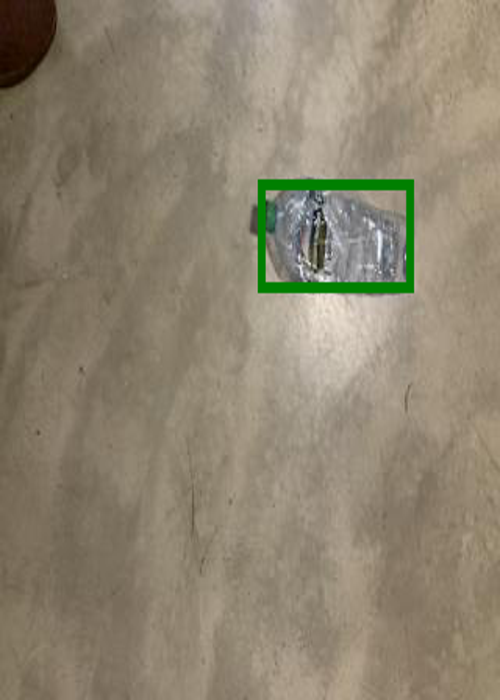

In [20]:
def viz_single_image(xml_path, resized=False, resize=True, width=30):
    tree = ET.parse(xml_path)
    root = tree.getroot()
    path = os.path.split(xml_path)[0]
    if resized:
        image_path = os.path.join(path, root.find('filename').text)
    else:
        image_path = root.find('path').text
    sample_image = Image.open(image_path)
    sample_image = ImageOps.exif_transpose(sample_image)

    sample_annotations = []
    class_names = []
    for neighbor in root.iter('object'):
        class_names.append(neighbor.find('name').text)
        xmin = int(neighbor.find('bndbox').find('xmin').text)
        ymin = int(neighbor.find('bndbox').find('ymin').text)
        xmax = int(neighbor.find('bndbox').find('xmax').text)
        ymax = int(neighbor.find('bndbox').find('ymax').text)
        sample_annotations.append([xmin, ymin, xmax, ymax])
    
    sample_image_annotated = sample_image.copy()
    img_bbox = ImageDraw.Draw(sample_image_annotated)
    for name, bbox in zip(class_names, sample_annotations):
        print(name)
        print(bbox)
        img_bbox.rectangle(bbox, outline="green", width=width) 
    
    if resize:
        sample_image_annotated = sample_image_annotated.resize((500, 700))
    display(sample_image_annotated)

viz_single_image('/content/drive/Shareddrives/Capstone/waste_detection/workspace/images_combined/resized_320/test/PET866.xml', resized=True, width=5)

In [ ]:
# TODO: fix to read xml file instead of image file
def viz_image_annotation(path):
    xml_list = glob.glob(path + '/*.xml')
    global selected_image_list
    selected_image_list = []
    # print(image_list)
    for i in range(10):
        idx = random.randint(0, len(image_list))
        selected_image = image_list[idx]
        selected_image_list.append(selected_image)
        sample_image = Image.open(selected_image)
        sample_image = ImageOps.exif_transpose(sample_image)
    
        tree = ET.parse(selected_image.replace('.jpg', '.xml'))
        root = tree.getroot()
        sample_annotations = []
        class_names = []
        for neighbor in root.iter('object'):
            class_names.append(neighbor.find('name').text)
            xmin = int(neighbor.find('bndbox').find('xmin').text)
            ymin = int(neighbor.find('bndbox').find('ymin').text)
            xmax = int(neighbor.find('bndbox').find('xmax').text)
            ymax = int(neighbor.find('bndbox').find('ymax').text)
            sample_annotations.append([xmin, ymin, xmax, ymax])
        
        sample_image_annotated = sample_image.copy()
        img_bbox = ImageDraw.Draw(sample_image_annotated)
        for name, bbox in zip(class_names, sample_annotations):
            print(name)
            print(bbox)
            img_bbox.rectangle(bbox, outline="green", width=30) 
        
        display(sample_image_annotated.resize((500, 700)))

Other plastic
[1752, 1037, 1863, 1106]


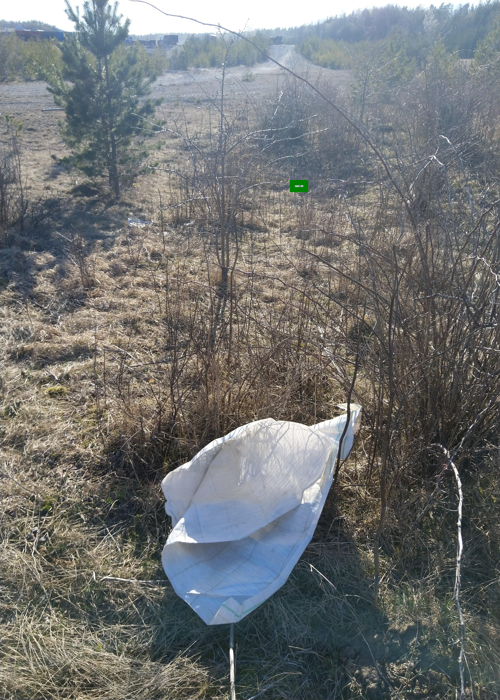

Plastic bag & wrapper
[760, 1830, 2210, 3906]


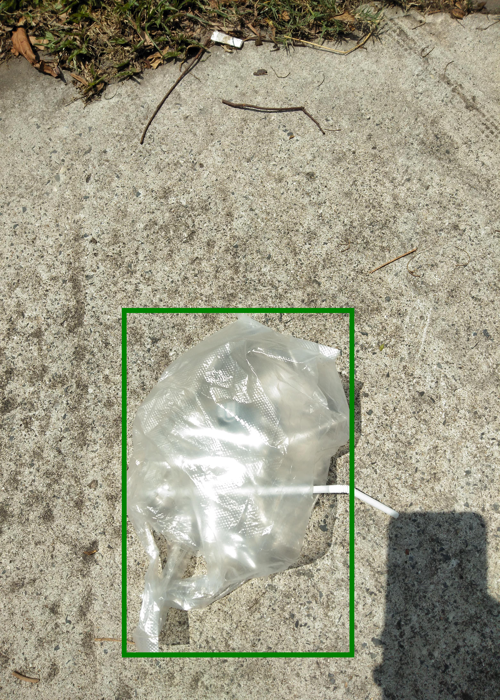

Bottle
[826, 744, 1290, 949]


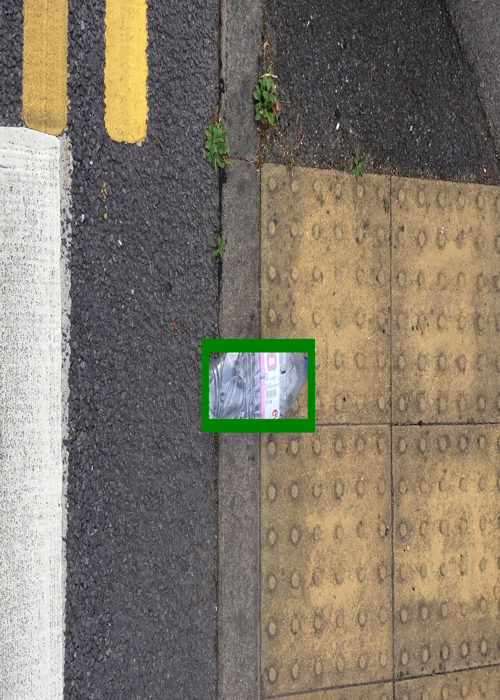

Can
[25, 1561, 2340, 2935]


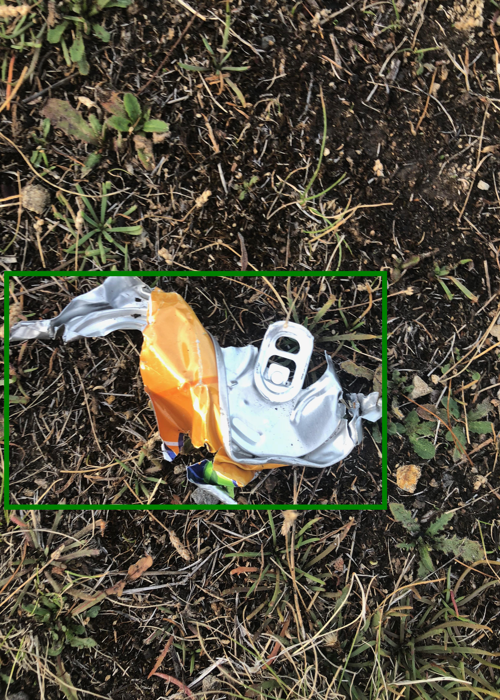

Bottle
[975, 367, 2038, 3953]


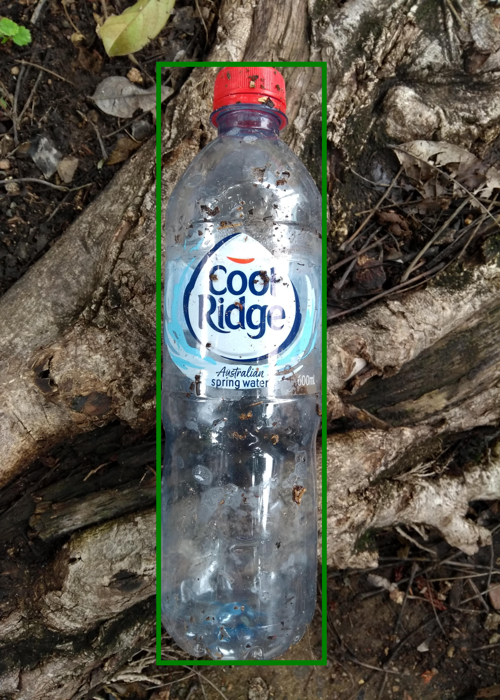

Cigarette
[1157, 1465, 1178, 1511]
Cigarette
[352, 1242, 403, 1269]


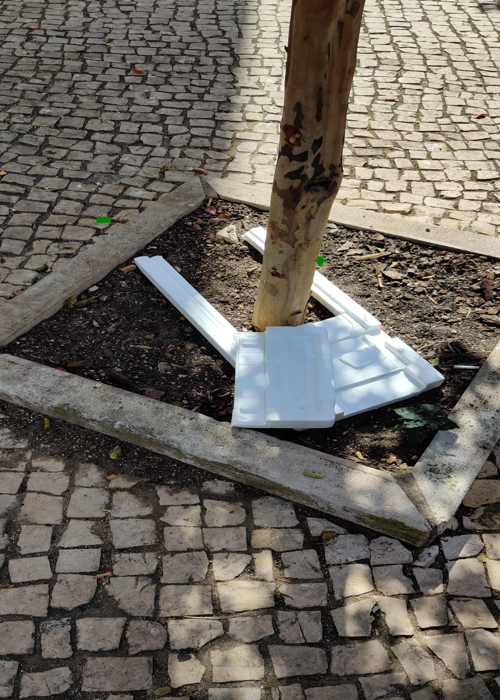

Bottle
[913, 1658, 961, 1720]
Cigarette
[1, 3464, 72, 3495]


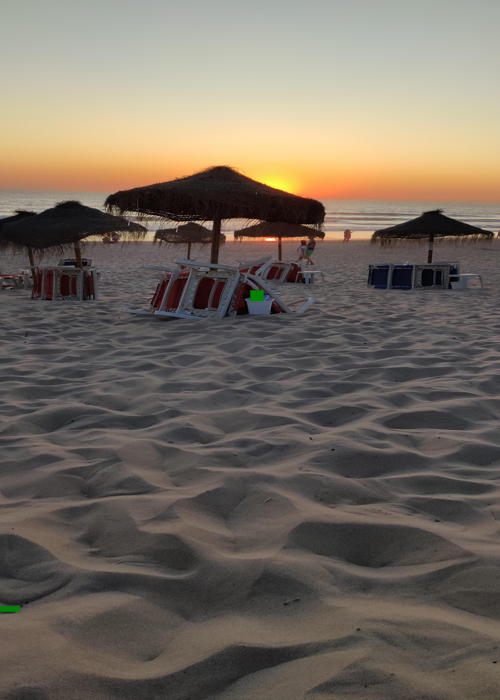

Bottle cap
[2258, 1709, 2770, 2046]


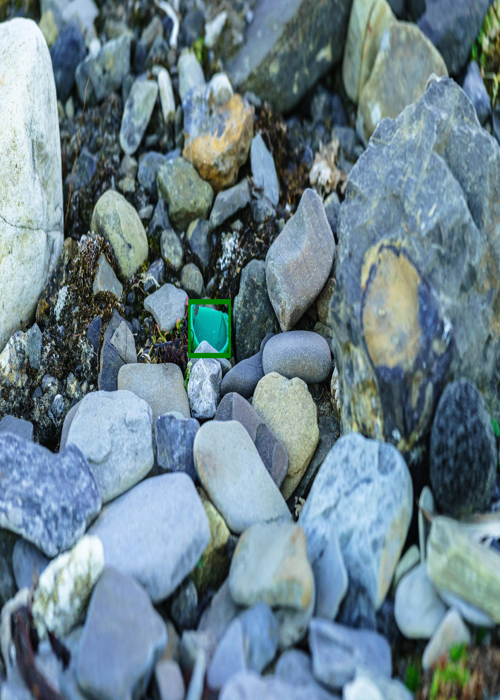

Cigarette
[1246, 560, 2887, 1598]


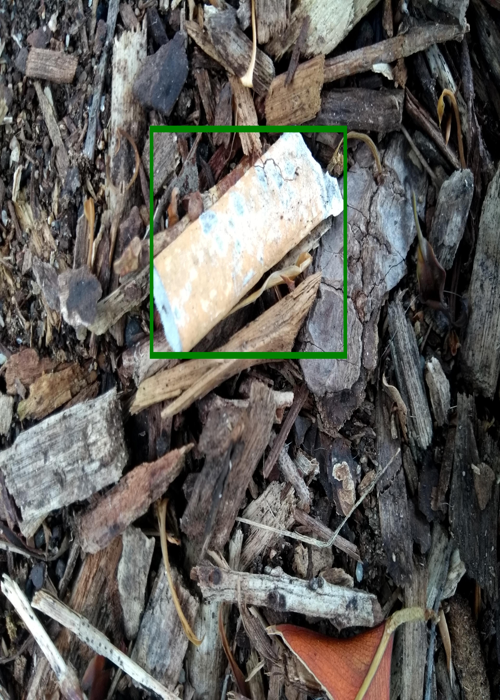

Cigarette
[1170, 2306, 1413, 2635]


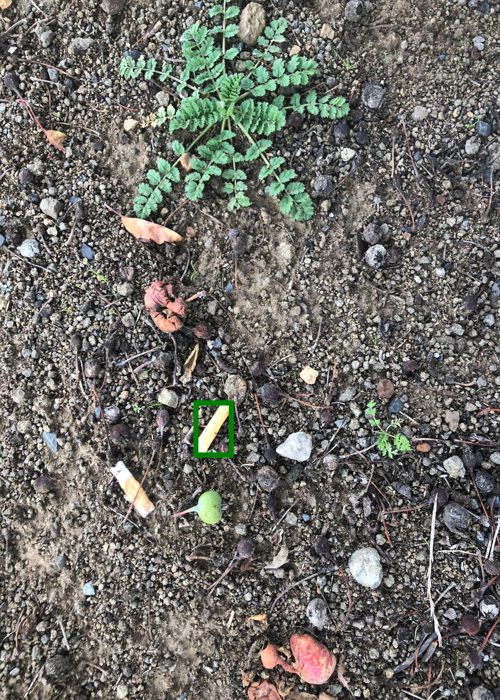

In [ ]:
viz_image_annotation(TEST_PATH)

In [ ]:
selected_image_list

['/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000060.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_12_000097.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_1_000001.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_14_000069.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_13_000092.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000015.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_10_000075.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000023.jpg',
 '/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_

### From coco annotations format

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000060.jpg


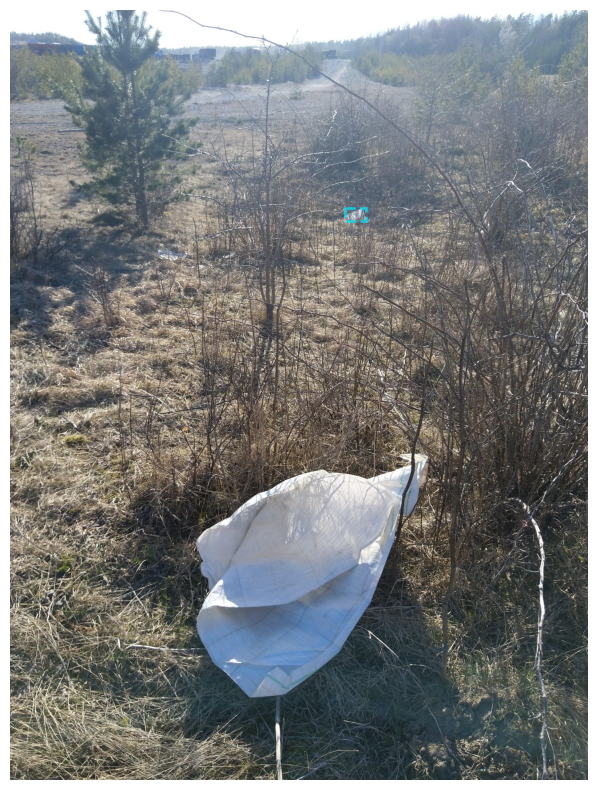

loading annotations into memory...
Done (t=0.19s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_12_000097.jpg


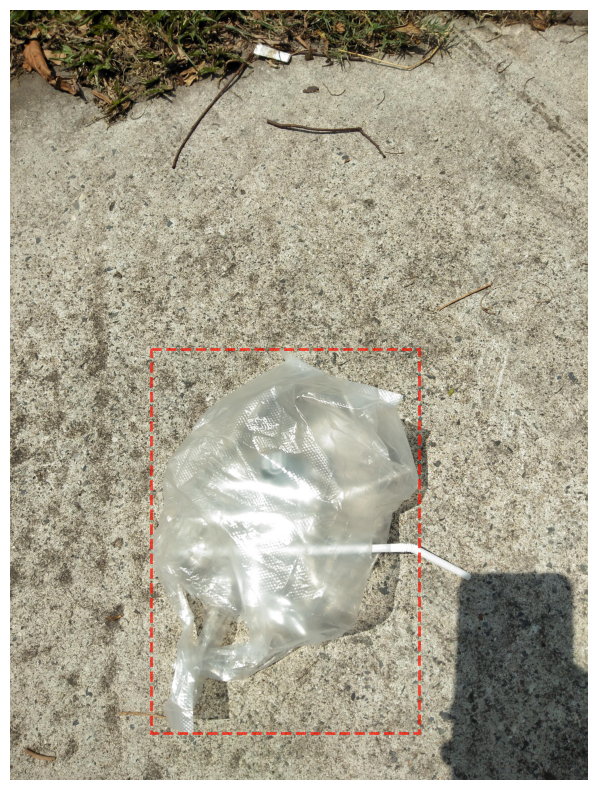

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_1_000001.jpg


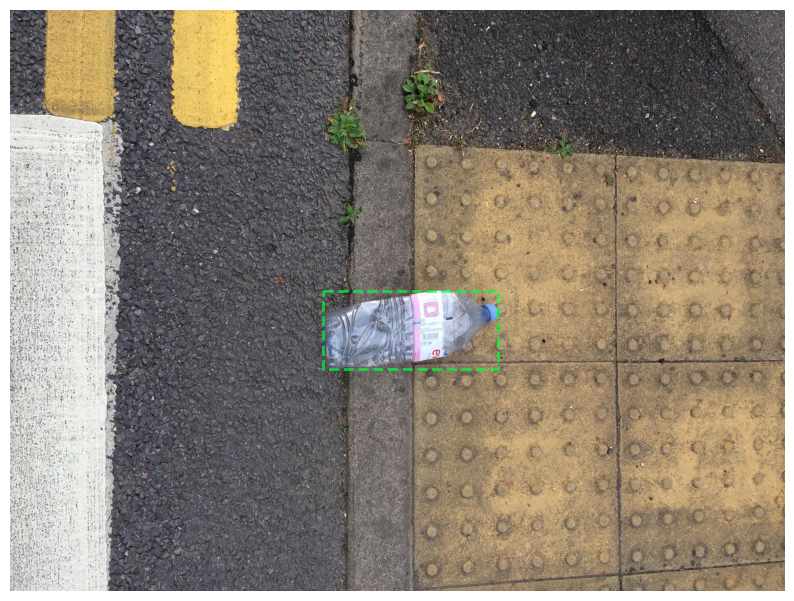

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_14_000069.jpg


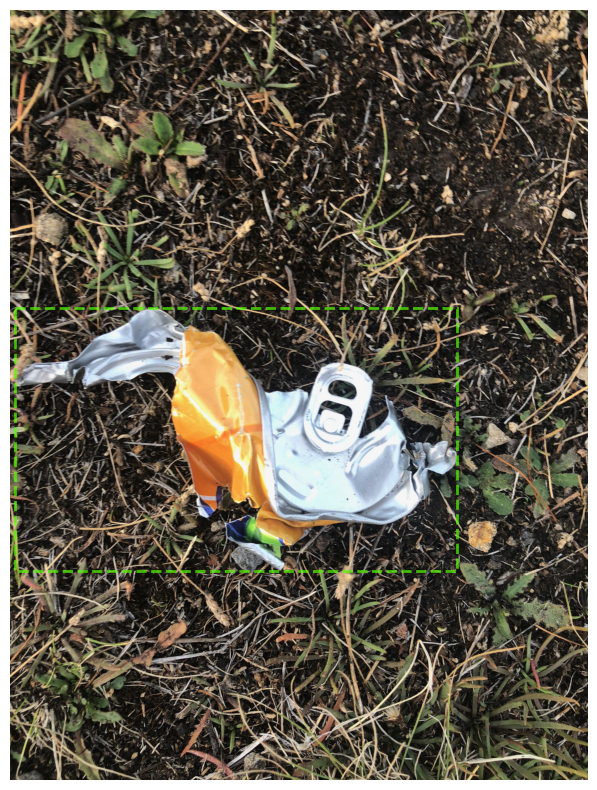

loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_13_000092.jpg


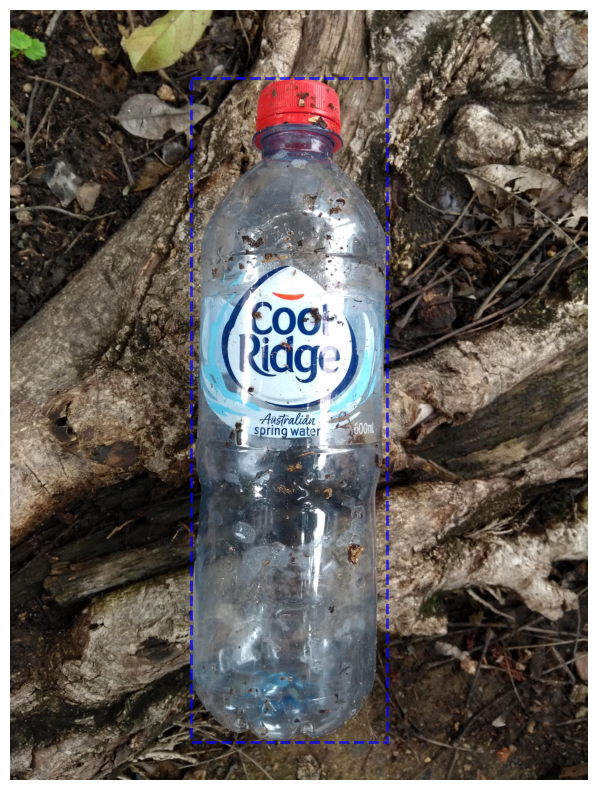

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000015.jpg


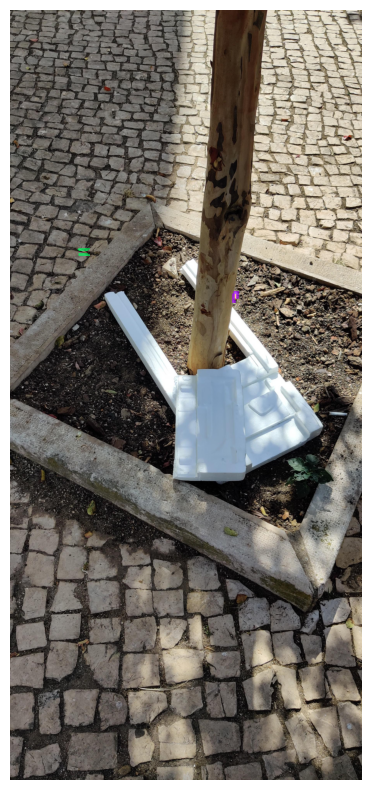

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_10_000075.jpg


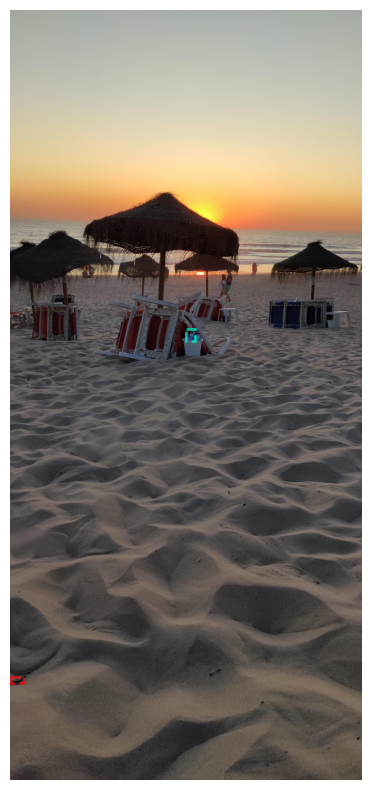

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_11_000023.jpg


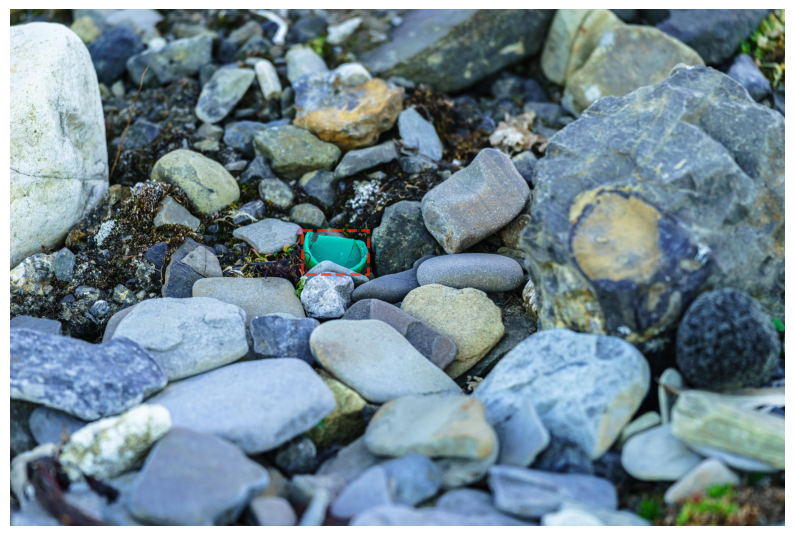

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_14_000011.jpg


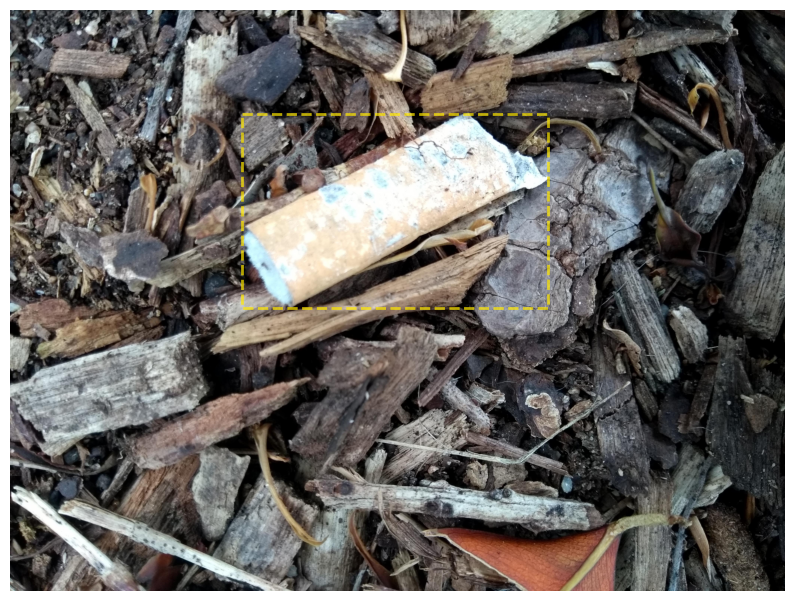

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
/content/drive/Shareddrives/Capstone/waste_detection/workspace/taco_images_label200/test/batch_14_000045.jpg


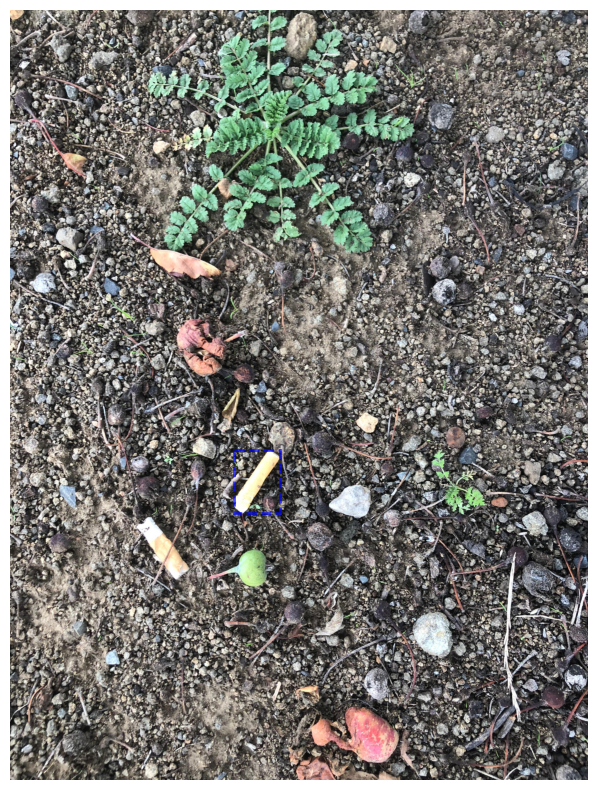

In [ ]:
from PIL import Image, ExifTags
from pycocotools.coco import COCO
from matplotlib.patches import Polygon, Rectangle
from matplotlib.collections import PatchCollection
import colorsys
import random
import pylab
import numpy as np

# read annotations
with open(TEST_ANN_PATH, 'r') as f:
    dataset = json.loads(f.read())
imgs = dataset['images']

# User settings
# image_filepath = 'batch_11/000028.jpg'
for image_filepath in selected_image_list:
    image_name = os.path.split(image_filepath)[-1]
    pylab.rcParams['figure.figsize'] = (10,10)
    ####################
    
    # Obtain Exif orientation tag code
    for orientation in ExifTags.TAGS.keys():
        if ExifTags.TAGS[orientation] == 'Orientation':
            break
    
    # Loads dataset as a coco object
    coco = COCO(TEST_ANN_PATH)
    
    # Find image id
    img_id = -1
    for img in imgs:
        if img['file_name'].replace('/', '_') == image_name:
            img_id = img['id']
            break
    
    # Show image and corresponding annotations
    if img_id == -1:
        print('Incorrect file name')
    else:
    
        # Load image
        print(image_filepath)
        I = Image.open(image_filepath)
    
        # Load and process image metadata
        if I._getexif():
            exif = dict(I._getexif().items())
            # Rotate portrait and upside down images if necessary
            if orientation in exif:
                if exif[orientation] == 3:
                    I = I.rotate(180,expand=True)
                if exif[orientation] == 6:
                    I = I.rotate(270,expand=True)
                if exif[orientation] == 8:
                    I = I.rotate(90,expand=True)
    
        # Show image
        fig,ax = plt.subplots(1)
        plt.axis('off')
        plt.imshow(I)
    
        # Load mask ids
        annIds = coco.getAnnIds(imgIds=img_id, catIds=[], iscrowd=None)
        anns_sel = coco.loadAnns(annIds)
    
        # Show annotations
        for ann in anns_sel:
            color = colorsys.hsv_to_rgb(np.random.random(),1,1)
            # for seg in ann['segmentation']:
            #     poly = Polygon(np.array(seg).reshape((int(len(seg)/2), 2)))
            #     p = PatchCollection([poly], facecolor=color, edgecolors=color,linewidths=0, alpha=0.4)
            #     ax.add_collection(p)
            #     p = PatchCollection([poly], facecolor='none', edgecolors=color, linewidths=2)
            #     ax.add_collection(p)
            [x, y, w, h] = ann['bbox']
            rect = Rectangle((x,y),w,h,linewidth=2,edgecolor=color,
                            facecolor='none', alpha=0.7, linestyle = '--')
            ax.add_patch(rect)
    
        plt.show()

All the images annotations are correctly converted

# Resizing Images

In [ ]:
!pip install -U git+https://github.com/albumentations-team/albumentations

In [5]:
import albumentations as A
import cv2
import numpy as np
import pandas as pd
from PIL import Image, ImageOps, ImageDraw
import xml.etree.ElementTree as ET
import glob
import matplotlib.pyplot as plt
import os

IMAGES_PATH = '/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images'
TEST_PATH = os.path.join(IMAGES_PATH, 'test')
TRAIN_PATH = os.path.join(IMAGES_PATH, 'train')
NEW_FOLDER_NAME = 'resized_320'

In [6]:
def resize_image(img_arr, bboxes, label_name, w, h):
    transform = A.Compose([
        A.Resize(h, w, always_apply=True)
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

    return transform(image=img_arr, bboxes=bboxes, class_labels=label_name)

In [12]:
def get_image_with_annotations(xml_annotation_path: str) -> tuple:
    """
    params: xml_annotations: String, path to xml annotation
    return: tuple, (images_array: np.array, bounding boxes: list, class_names: list)
    """
    tree = ET.parse(xml_annotation_path)
    root = tree.getroot()
    image_path = root.find('path').text

    bboxes = []
    class_names = []
    for neighbor in root.iter('object'):
        class_names.append(neighbor.find('name').text)
        xmin = int(neighbor.find('bndbox').find('xmin').text)
        ymin = int(neighbor.find('bndbox').find('ymin').text)
        xmax = int(neighbor.find('bndbox').find('xmax').text)
        ymax = int(neighbor.find('bndbox').find('ymax').text)
        bboxes.append([xmin, ymin, xmax, ymax])

    # read the file and convert it to array
    im = Image.open(image_path)
    im = ImageOps.exif_transpose(im)
    im_arr = np.asarray(im)

    return im_arr, bboxes, class_names

test_get = get_image_with_annotations('/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images/train/AluCan1,004.xml')
test_get[1:]

([[73, 480, 254, 630]], ['Can'])

In [13]:
def display_image_with_bbox(transformed: dict):
    # print(transformed)
    image_arr = transformed['image']
    bboxes = transformed['bboxes']
    class_labels = transformed['class_labels']
    sample_image = Image.fromarray(image_arr)

    sample_image_annotated = sample_image.copy()
    img_bbox = ImageDraw.Draw(sample_image_annotated)
    for name, bbox in zip(class_labels, bboxes):
        img_bbox.rectangle(bbox, outline="green", width=5) 
        
    display(sample_image_annotated)

In [14]:
def export_image_with_annotations(transformed, dst_dir, xml_path, size):
    if not os.path.exists(dst_dir):
        os.makedirs(dst_dir)

    xml_filename = os.path.split(xml_path)[-1]

    image_arr = transformed['image']
    bboxes = transformed['bboxes']
    bboxes = np.array(bboxes).astype(int).astype(str)
    class_labels = transformed['class_labels']

    tree = ET.parse(xml_path)
    root = tree.getroot()
    image_filename = root.find('filename').text
    i = 0
    for bndbox in root.iter('bndbox'):
        bndbox.find('xmin').text = bboxes[i][0]
        bndbox.find('ymin').text = bboxes[i][1]
        bndbox.find('xmax').text = bboxes[i][2]
        bndbox.find('ymax').text = bboxes[i][3]
        i += 1
    root.find('size/width').text = str(size)
    root.find('size/height').text = str(size)
    tree.write(os.path.join(dst_dir, xml_filename))

    im = Image.fromarray(image_arr)
    im.save(os.path.join(dst_dir, image_filename))

In [15]:
def resize_and_export(src_dir, dst_dir, size, display=False):
    cnt = 1
    failure_cnt = 0
    for xml_path in glob.glob(src_dir + '/*.xml'):
        try:
            img_arr, bboxes, label_name = get_image_with_annotations(xml_path)
            transformed_dict = resize_image(img_arr, bboxes, label_name, size, size)
            export_image_with_annotations(transformed_dict, dst_dir, xml_path, size)
        except Exception as e:
            failure_cnt += 1
            print(e)
            print(xml_path)
            print()
            continue

        if cnt % 500 == 0:
            if display:
                display_image_with_bbox(transformed_dict)
            print('image', cnt)
        cnt += 1
    print('done', f'with {failure_cnt} failure')

In [ ]:
resize_and_export(TEST_PATH, '/content/test_320', 320)

Sanity check

Can
[148, 171, 238, 221]


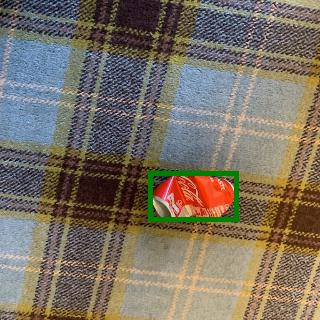

In [21]:
viz_single_image('/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images/resized_320/test/AluCan1,002.xml', resized=True, resize=False, width=5)

Resize it

In [ ]:
# !rm -rf {os.path.join(IMAGES_PATH, NEW_FOLDER_NAME, 'train')}

In [16]:
IMAGES_PATH

'/content/drive/Shareddrives/Capstone/waste_detection/workspace/kaggle_images'

In [ ]:
resize_and_export(TEST_PATH, os.path.join(IMAGES_PATH, 'resized_640', 'test'), 640)
resize_and_export(TRAIN_PATH, os.path.join(IMAGES_PATH, 'resized_640', 'train'), 640)

In [ ]:
resize_and_export(TEST_PATH, os.path.join(IMAGES_PATH, 'resized_320', 'test'), 320)
resize_and_export(TRAIN_PATH, os.path.join(IMAGES_PATH, 'resized_320', 'train'), 320)